# Interpretability of pain behavior recognition

## First we need dataframes for every subject

In [1]:
import sys
sys.path.append('../')

%matplotlib inline

# DEFINE GRAPH
import pandas as pd
import numpy as np

import utils

from importlib import reload
reload(utils)

pd.set_option('max_colwidth', 800) 

/Users/sbroome/miniconda2/envs/py365/lib/python3.6/importlib/_bootstrap.py:219: ImportWarning: can't resolve package from __spec__ or __package__, falling back on __name__ and __path__
  return f(*args, **kwds)
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/importlib/_bootstrap_external.py:426: ImportWarning: Not importing directory /Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/google: missing __init__
  _warnings.warn(msg.format(portions[0]), ImportWarning)
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/importlib/_bootstrap_external.py:426: ImportWarning: Not importing directory /Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/mpl_toolkits: missing __init__
  _warnings.warn(msg.format(portions[0]), ImportWarning)
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/tensorflow/python/framework/ops.py:923: DeprecationWarning: builtin type EagerTensor has no __module__ attribute
  EagerTensor = c_api.TFE_Py_InitEagerTensor(_EagerTens

In [2]:
%%javascript
IPython.OutputArea.prototype._should_scroll = function(lines) {
    return false;
}

<IPython.core.display.Javascript object>

In [5]:
# Data paths
rgb_path = '../data/jpg_128_128_2fps/'
of_path = '../data/jpg_128_128_16fps_OF_magnitude_cv2/'

# Hyperparameters
input_width = 128
input_height = 128
seq_length = 10
seq_stride = 10
batch_size = 1
COLOR = True
nb_labels = 2

# Data augmentation
aug_flip = 0
aug_crop = 0
aug_light = 0

nb_input_dims =5

subject_ids = pd.read_csv('../metadata/horse_subjects.csv')['Subject'].values
channels = 3

In [6]:
from utils import ArgsProxy
args = ArgsProxy(rgb_path, of_path, input_height, input_width,
                 seq_length, seq_stride, batch_size, nb_labels,
                 aug_flip, aug_crop, aug_light, nb_input_dims)

In [7]:
import data_handler as dathand
dh = dathand.DataHandler(path=args.data_path,
                 of_path=args.of_path,
                 clip_list_file='videos_overview_missingremoved.csv',
                 data_columns=['Pain'],  # Here one can append f. ex. 'Observer'
                 image_size=(args.input_height, args.input_width),
                 seq_length=args.seq_length,
                 seq_stride=args.seq_stride,
                 batch_size=args.batch_size,
                 color=COLOR,
                 nb_labels=args.nb_labels,
                 aug_flip=args.aug_flip,
                 aug_crop=args.aug_crop,
                 aug_light=args.aug_light,
                 nb_input_dims=args.nb_input_dims)

In [8]:
import utils
subject_dfs = utils.read_or_create_subject_dfs(dh, args, subject_ids)

../data/jpg_128_128_2fps/
../data/jpg_128_128_2fps/
../data/jpg_128_128_2fps/
../data/jpg_128_128_2fps/
../data/jpg_128_128_2fps/
../data/jpg_128_128_2fps/


In [9]:
subject_dfs = utils.read_or_create_subject_rgb_and_OF_dfs(dh, args, subject_ids, subject_dfs)

In [10]:
sequence_df = utils.get_sequence(args=args, subject_dfs=subject_dfs, subject=4)
y = sequence_df['Pain'].values
image_paths = sequence_df['Path'].values
of_paths = sequence_df['OF_Path'].values

Chose subject  4
Start index in subject dataframe:  11068


In [11]:
from keras.utils import np_utils
label_onehot = np_utils.to_categorical(y, num_classes=args.nb_labels)
label_onehot
batch_label = label_onehot.reshape(args.batch_size, args.seq_length, -1)

batch_img = np.concatenate(utils.read_images_and_return_list(args, image_paths, 'local'), axis=1)
batch_flow = np.concatenate(utils.read_images_and_return_list(args, of_paths, 'local'), axis=1)

## Now that we have frames from all subjects, we can import gradcam functionality

In [12]:
# Choose a model to work on
two_stream = True

if two_stream: # This model got 88.09 % F1-score
    best_model_path = '../models/BEST_MODEL_2stream_5d_adadelta_LSTMunits_32_CONVfilters_16_add_v4_t0_4hl_128jpg2fps_seq10_bs8_adadelta_noaug_run1_rerun_for_gradcam.h5'
else:
    best_model_path = '../models/1stream_summer_2018/no_aug/BEST_MODEL_convolutional_LSTM_adadelta_LSTMunits_32_CONVfilters_None_jpg128_2fps_val0_t4_seq10ss10_4hl_32ubs16_no_aug_run4.h5'
import keras
m = keras.models.load_model(best_model_path)

In [13]:
from keras import backend as K
import tensorflow as tf
    
images = tf.placeholder(tf.float32, [batch_size, args.seq_length, args.input_width, args.input_height, channels])
flows = tf.placeholder(tf.float32, [batch_size, args.seq_length, args.input_width, args.input_height, channels])
labels = tf.placeholder(tf.float32, [batch_size, args.seq_length, 2])

if two_stream:
    clstm_model = utils.TwoStreamCLSTMNetwork(images, flows, from_scratch=0, path=best_model_path)
else:
    clstm_model = utils.CLSTMNetwork(images, from_scratch=0, path=best_model_path)

sess = K.get_session()  # Grab the Keras session where the weights are initialized.

cost = (-1) * tf.reduce_sum(tf.multiply(labels, tf.log(clstm_model.preds)), axis=1)
    
y_c = tf.reduce_sum(tf.multiply(clstm_model.dense, labels), axis=1)

print('model preds: ', clstm_model.preds)
print('cost: ', cost)
print('y_c: ', y_c)


    
if two_stream:
    target_conv_layer = clstm_model.clstm4_rgb # Choose which CLSTM-layer to study
    # target_conv_layer = clstm_model.clstm1_rgb # Choose which CLSTM-layer to study
    # target_conv_layer = clstm_model.merge # Choose which CLSTM-layer to study
else:
    target_conv_layer = clstm_model.clstm4 # Choose which CLSTM-layer to study
    
print('tcl: ', target_conv_layer)
print('TYPE tcl: ', type(target_conv_layer))
    
target_conv_layer_grad = tf.gradients(y_c, target_conv_layer)[0]

print('tclg: ', target_conv_layer_grad)
    
gb_grad = tf.gradients(cost, [images, flows])[0]  # Guided backpropagation back to input layer

model preds:  Tensor("activation_1_2/Sigmoid:0", shape=(1, 10, 2), dtype=float32)
cost:  Tensor("mul_1:0", shape=(1, 2), dtype=float32)
y_c:  Tensor("Sum_1:0", shape=(1, 2), dtype=float32)
tcl:  Tensor("conv_lst_m2d_4_2/transpose_1:0", shape=(1, ?, 16, 16, 32), dtype=float32)
TYPE tcl:  <class 'tensorflow.python.framework.ops.Tensor'>
tclg:  Tensor("gradients/time_distributed_4_2/transpose_grad/transpose:0", shape=(1, ?, 16, 16, 32), dtype=float32)


In [16]:
def run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True):
    with sess.as_default():

        # 2-stream
        if two_stream:
            prob = sess.run(clstm_model.preds,
                            feed_dict={images: batch_img,
                                       flows: batch_flow,
                                       K.learning_phase(): 0})

            print(prob)

            gb_grad_value, target_conv_layer_value, target_conv_layer_grad_value =                 sess.run([gb_grad, target_conv_layer, target_conv_layer_grad],
                          feed_dict={images: batch_img,
                                     flows: batch_flow,
                                     labels: batch_label,
                                     K.learning_phase(): 0})

            target_conv_layer_value = np.reshape(target_conv_layer_value,
                                             (1, 10, 16, 16, 32))
            target_conv_layer_grad_value = np.reshape(target_conv_layer_grad_value,
                                             (1, 10, 16, 16, 32))
            
        else:
            prob = sess.run(clstm_model.preds,
                            feed_dict={images: batch_img,
                                       K.learning_phase(): 0})

            print(prob)
            gb_grad_value, target_conv_layer_value, target_conv_layer_grad_value =                 sess.run([gb_grad, target_conv_layer, target_conv_layer_grad],
                          feed_dict={images: batch_img,
                          labels: batch_label,
                          K.learning_phase(): 0})
            target_conv_layer_value = np.reshape(target_conv_layer_value,
                                         (1, 10, 16, 16, 32))
            target_conv_layer_grad_value = np.reshape(target_conv_layer_grad_value,
                                         (1, 10, 16, 16, 32))


        utils.visualize_overlays(batch_img, target_conv_layer_value,
                           target_conv_layer_grad_value, args, batch_flow)


# Two-stream predictions for subject 0

Chose subject  0
Start index in subject dataframe:  4222
                                                  Path  Pain
0  data/jpg_128_128_2fps/horse_1/1_2a/frame_000575.jpg     0
1  data/jpg_128_128_2fps/horse_1/1_2a/frame_000576.jpg     0
2  data/jpg_128_128_2fps/horse_1/1_2a/frame_000577.jpg     0
3  data/jpg_128_128_2fps/horse_1/1_2a/frame_000578.jpg     0
4  data/jpg_128_128_2fps/horse_1/1_2a/frame_000579.jpg     0
5  data/jpg_128_128_2fps/horse_1/1_2a/frame_000580.jpg     0
6  data/jpg_128_128_2fps/horse_1/1_2a/frame_000581.jpg     0
7  data/jpg_128_128_2fps/horse_1/1_2a/frame_000582.jpg     0
8  data/jpg_128_128_2fps/horse_1/1_2a/frame_000583.jpg     0
9  data/jpg_128_128_2fps/horse_1/1_2a/frame_000584.jpg     0
[[[0.567938   0.36784816]
  [0.6823272  0.30284113]
  [0.6930298  0.20191269]
  [0.69029564 0.11191689]
  [0.7511903  0.08858284]
  [0.7814308  0.11476406]
  [0.7942714  0.1294479 ]
  [0.84083694 0.15248987]
  [0.83727115 0.18164778]
  [0.80467373 0.21109426]]]


/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


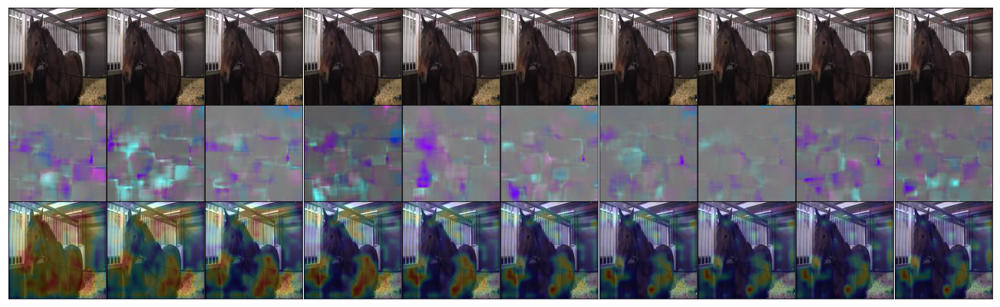

In [18]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=0)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  0
Start index in subject dataframe:  6587
                                                  Path  Pain
0  data/jpg_128_128_2fps/horse_1/1_2b/frame_000270.jpg     0
1  data/jpg_128_128_2fps/horse_1/1_2b/frame_000271.jpg     0
2  data/jpg_128_128_2fps/horse_1/1_2b/frame_000272.jpg     0
3  data/jpg_128_128_2fps/horse_1/1_2b/frame_000273.jpg     0
4  data/jpg_128_128_2fps/horse_1/1_2b/frame_000274.jpg     0
5  data/jpg_128_128_2fps/horse_1/1_2b/frame_000275.jpg     0
6  data/jpg_128_128_2fps/horse_1/1_2b/frame_000276.jpg     0
7  data/jpg_128_128_2fps/horse_1/1_2b/frame_000277.jpg     0
8  data/jpg_128_128_2fps/horse_1/1_2b/frame_000278.jpg     0
9  data/jpg_128_128_2fps/horse_1/1_2b/frame_000279.jpg     0
[[[0.6704359  0.3015744 ]
  [0.8664712  0.09687452]
  [0.9307144  0.02209947]
  [0.9596185  0.01840136]
  [0.9683206  0.03287131]
  [0.94331586 0.07956687]
  [0.91340727 0.21879193]
  [0.879408   0.43065107]
  [0.8658813  0.59704715]
  [0.86689866 0.58742464]]]


/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


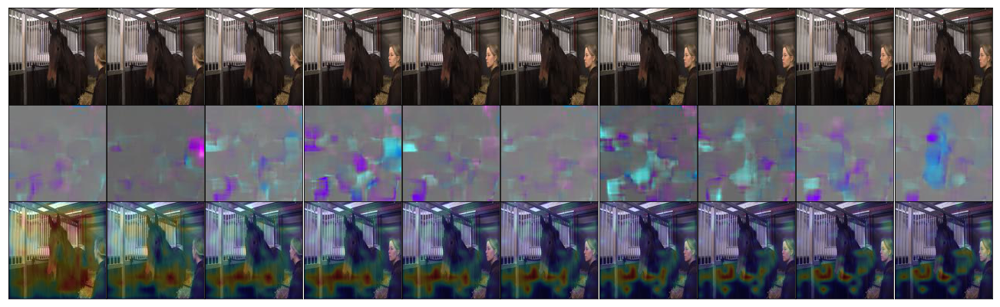

In [19]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=0)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  0
Start index in subject dataframe:  1393
                                                    Path  Pain
0  data/jpg_128_128_2fps/horse_1/1_1a_3/frame_000674.jpg     0
1  data/jpg_128_128_2fps/horse_1/1_1a_3/frame_000675.jpg     0
2  data/jpg_128_128_2fps/horse_1/1_1a_3/frame_000676.jpg     0
3  data/jpg_128_128_2fps/horse_1/1_1a_3/frame_000677.jpg     0
4  data/jpg_128_128_2fps/horse_1/1_1a_3/frame_000678.jpg     0
5  data/jpg_128_128_2fps/horse_1/1_1a_3/frame_000679.jpg     0
6  data/jpg_128_128_2fps/horse_1/1_1a_3/frame_000680.jpg     0
7  data/jpg_128_128_2fps/horse_1/1_1a_3/frame_000681.jpg     0
8  data/jpg_128_128_2fps/horse_1/1_1a_3/frame_000682.jpg     0
9  data/jpg_128_128_2fps/horse_1/1_1a_3/frame_000683.jpg     0
[[[0.71161425 0.3077736 ]
  [0.84810126 0.14106289]
  [0.8243824  0.04088135]
  [0.86296254 0.02051212]
  [0.914922   0.01303452]
  [0.95759535 0.01333676]
  [0.97248286 0.01465178]
  [0.97859997 0.01097048]
  [0.97952205 0.00856038]
  [0.9770083  0.

/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


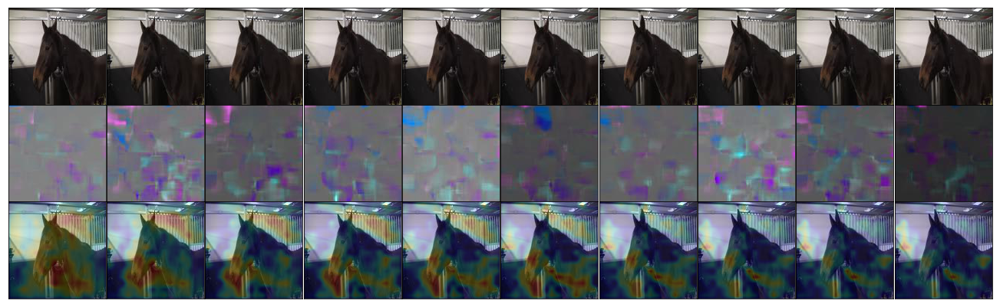

In [20]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=0)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  0
Start index in subject dataframe:  959
                                                    Path  Pain
0  data/jpg_128_128_2fps/horse_1/1_1a_3/frame_000240.jpg     0
1  data/jpg_128_128_2fps/horse_1/1_1a_3/frame_000241.jpg     0
2  data/jpg_128_128_2fps/horse_1/1_1a_3/frame_000242.jpg     0
3  data/jpg_128_128_2fps/horse_1/1_1a_3/frame_000243.jpg     0
4  data/jpg_128_128_2fps/horse_1/1_1a_3/frame_000244.jpg     0
5  data/jpg_128_128_2fps/horse_1/1_1a_3/frame_000245.jpg     0
6  data/jpg_128_128_2fps/horse_1/1_1a_3/frame_000246.jpg     0
7  data/jpg_128_128_2fps/horse_1/1_1a_3/frame_000247.jpg     0
8  data/jpg_128_128_2fps/horse_1/1_1a_3/frame_000248.jpg     0
9  data/jpg_128_128_2fps/horse_1/1_1a_3/frame_000249.jpg     0
[[[0.6823847  0.3248564 ]
  [0.87832814 0.15374893]
  [0.87837255 0.04064699]
  [0.88105357 0.01195919]
  [0.90408474 0.00636588]
  [0.9474739  0.00471661]
  [0.9668627  0.00461786]
  [0.97765994 0.0048147 ]
  [0.9829874  0.00423953]
  [0.9853931  0.0

/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


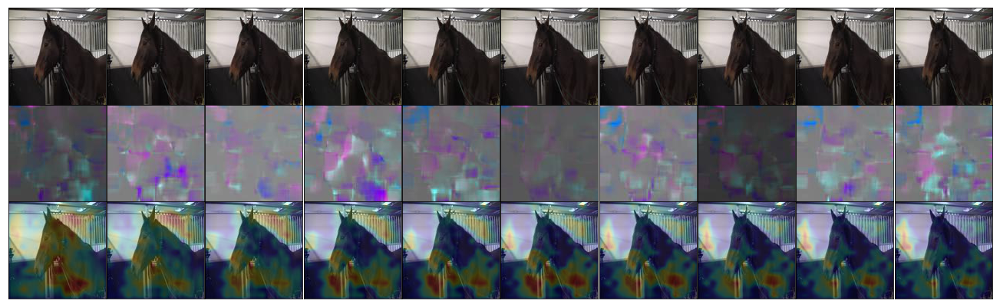

In [21]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=0)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  0
Start index in subject dataframe:  13636
                                                   Path  Pain
0  data/jpg_128_128_2fps/horse_1/1_5_1/frame_000863.jpg     1
1  data/jpg_128_128_2fps/horse_1/1_5_1/frame_000864.jpg     1
2  data/jpg_128_128_2fps/horse_1/1_5_1/frame_000865.jpg     1
3  data/jpg_128_128_2fps/horse_1/1_5_1/frame_000866.jpg     1
4  data/jpg_128_128_2fps/horse_1/1_5_1/frame_000867.jpg     1
5  data/jpg_128_128_2fps/horse_1/1_5_1/frame_000868.jpg     1
6  data/jpg_128_128_2fps/horse_1/1_5_1/frame_000869.jpg     1
7  data/jpg_128_128_2fps/horse_1/1_5_1/frame_000870.jpg     1
8  data/jpg_128_128_2fps/horse_1/1_5_1/frame_000871.jpg     1
9  data/jpg_128_128_2fps/horse_1/1_5_1/frame_000872.jpg     1
[[[0.5359445  0.4133691 ]
  [0.53280777 0.57101834]
  [0.4370929  0.79015696]
  [0.43943065 0.90209264]
  [0.50504464 0.9464797 ]
  [0.56119925 0.96901244]
  [0.5965344  0.95950526]
  [0.58194053 0.94264245]
  [0.5743379  0.9313504 ]
  [0.572575   0.9233804 ]]

/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


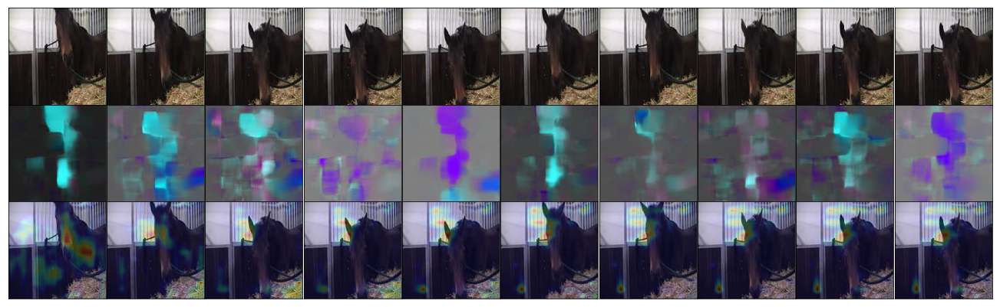

In [22]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=0)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  0
Start index in subject dataframe:  1066
                                                    Path  Pain
0  data/jpg_128_128_2fps/horse_1/1_1a_3/frame_000347.jpg     0
1  data/jpg_128_128_2fps/horse_1/1_1a_3/frame_000348.jpg     0
2  data/jpg_128_128_2fps/horse_1/1_1a_3/frame_000349.jpg     0
3  data/jpg_128_128_2fps/horse_1/1_1a_3/frame_000350.jpg     0
4  data/jpg_128_128_2fps/horse_1/1_1a_3/frame_000351.jpg     0
5  data/jpg_128_128_2fps/horse_1/1_1a_3/frame_000352.jpg     0
6  data/jpg_128_128_2fps/horse_1/1_1a_3/frame_000353.jpg     0
7  data/jpg_128_128_2fps/horse_1/1_1a_3/frame_000354.jpg     0
8  data/jpg_128_128_2fps/horse_1/1_1a_3/frame_000355.jpg     0
9  data/jpg_128_128_2fps/horse_1/1_1a_3/frame_000356.jpg     0
[[[0.7608423  0.28889248]
  [0.8986748  0.10783383]
  [0.84665895 0.04387783]
  [0.8656303  0.02456664]
  [0.89729875 0.01664666]
  [0.926179   0.01496328]
  [0.94621795 0.01423743]
  [0.95741445 0.0187548 ]
  [0.9588342  0.02088192]
  [0.96771574 0.

/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


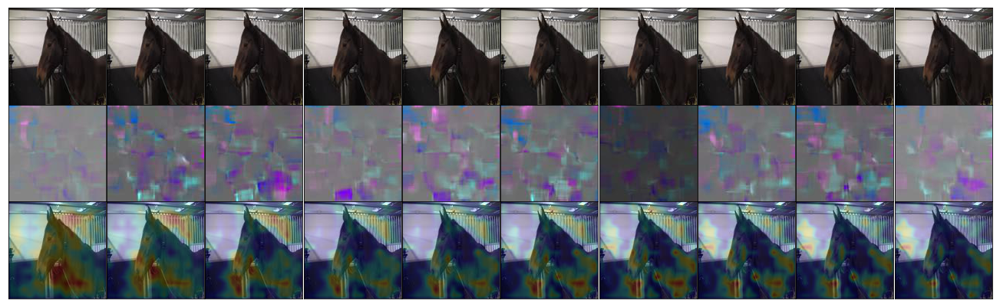

In [23]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=0)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  0
Start index in subject dataframe:  12327
                                                 Path  Pain
0  data/jpg_128_128_2fps/horse_1/1_4/frame_001354.jpg     1
1  data/jpg_128_128_2fps/horse_1/1_4/frame_001355.jpg     1
2  data/jpg_128_128_2fps/horse_1/1_4/frame_001356.jpg     1
3  data/jpg_128_128_2fps/horse_1/1_4/frame_001357.jpg     1
4  data/jpg_128_128_2fps/horse_1/1_4/frame_001358.jpg     1
5  data/jpg_128_128_2fps/horse_1/1_4/frame_001359.jpg     1
6  data/jpg_128_128_2fps/horse_1/1_4/frame_001360.jpg     1
7  data/jpg_128_128_2fps/horse_1/1_4/frame_001361.jpg     1
8  data/jpg_128_128_2fps/horse_1/1_4/frame_001362.jpg     1
9  data/jpg_128_128_2fps/horse_1/1_4/frame_001363.jpg     1
[[[0.5818499  0.46913812]
  [0.34911466 0.78999025]
  [0.09521914 0.94560975]
  [0.03618063 0.9758337 ]
  [0.02645481 0.9790044 ]
  [0.03745282 0.9688584 ]
  [0.06267681 0.9431942 ]
  [0.07268839 0.9151769 ]
  [0.07740264 0.88841707]
  [0.08342383 0.87680674]]]


/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


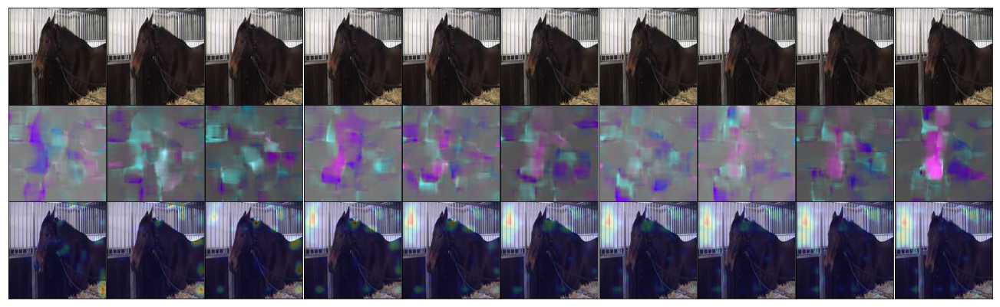

In [25]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=0)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  0
Start index in subject dataframe:  6498
                                                  Path  Pain
0  data/jpg_128_128_2fps/horse_1/1_2b/frame_000181.jpg     0
1  data/jpg_128_128_2fps/horse_1/1_2b/frame_000182.jpg     0
2  data/jpg_128_128_2fps/horse_1/1_2b/frame_000183.jpg     0
3  data/jpg_128_128_2fps/horse_1/1_2b/frame_000184.jpg     0
4  data/jpg_128_128_2fps/horse_1/1_2b/frame_000185.jpg     0
5  data/jpg_128_128_2fps/horse_1/1_2b/frame_000186.jpg     0
6  data/jpg_128_128_2fps/horse_1/1_2b/frame_000187.jpg     0
7  data/jpg_128_128_2fps/horse_1/1_2b/frame_000188.jpg     0
8  data/jpg_128_128_2fps/horse_1/1_2b/frame_000189.jpg     0
9  data/jpg_128_128_2fps/horse_1/1_2b/frame_000190.jpg     0
[[[0.66679317 0.3529161 ]
  [0.9117014  0.14346677]
  [0.96779007 0.04736543]
  [0.9830797  0.02728327]
  [0.9883485  0.03801436]
  [0.99081844 0.05419741]
  [0.99077964 0.09290176]
  [0.9865806  0.12165112]
  [0.97980344 0.13240586]
  [0.973118   0.13978842]]]


/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


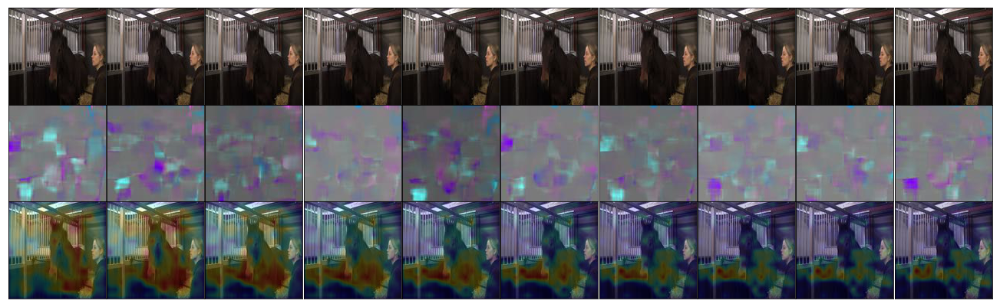

In [26]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=0)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  0
Start index in subject dataframe:  3382
                                                  Path  Pain
0  data/jpg_128_128_2fps/horse_1/1_1b/frame_000711.jpg     0
1  data/jpg_128_128_2fps/horse_1/1_1b/frame_000712.jpg     0
2  data/jpg_128_128_2fps/horse_1/1_1b/frame_000713.jpg     0
3  data/jpg_128_128_2fps/horse_1/1_1b/frame_000714.jpg     0
4  data/jpg_128_128_2fps/horse_1/1_1b/frame_000715.jpg     0
5  data/jpg_128_128_2fps/horse_1/1_1b/frame_000716.jpg     0
6  data/jpg_128_128_2fps/horse_1/1_1b/frame_000717.jpg     0
7  data/jpg_128_128_2fps/horse_1/1_1b/frame_000718.jpg     0
8  data/jpg_128_128_2fps/horse_1/1_1b/frame_000719.jpg     0
9  data/jpg_128_128_2fps/horse_1/1_1b/frame_000720.jpg     0
[[[0.64272565 0.32688662]
  [0.80425984 0.2088887 ]
  [0.70828444 0.11889803]
  [0.7045879  0.06419747]
  [0.8048841  0.05634735]
  [0.8654928  0.05811373]
  [0.8489918  0.08449008]
  [0.85699624 0.10058562]
  [0.8973642  0.10169283]
  [0.93431634 0.08382866]]]


/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


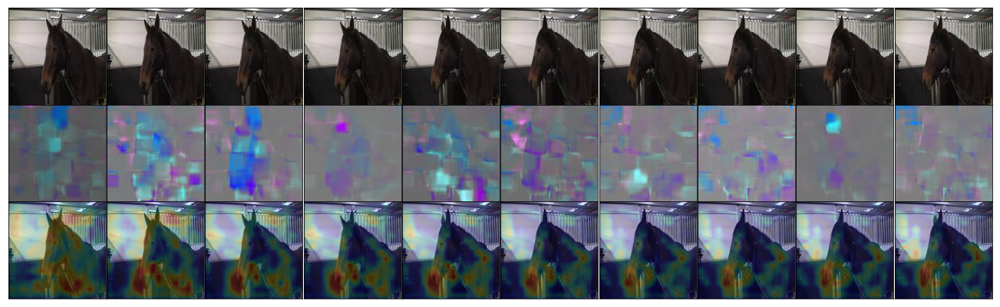

In [27]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=0)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  0
Start index in subject dataframe:  5795
                                                  Path  Pain
0  data/jpg_128_128_2fps/horse_1/1_2a/frame_002148.jpg     0
1  data/jpg_128_128_2fps/horse_1/1_2a/frame_002149.jpg     0
2  data/jpg_128_128_2fps/horse_1/1_2a/frame_002150.jpg     0
3  data/jpg_128_128_2fps/horse_1/1_2a/frame_002151.jpg     0
4  data/jpg_128_128_2fps/horse_1/1_2a/frame_002152.jpg     0
5  data/jpg_128_128_2fps/horse_1/1_2a/frame_002153.jpg     0
6  data/jpg_128_128_2fps/horse_1/1_2a/frame_002154.jpg     0
7  data/jpg_128_128_2fps/horse_1/1_2a/frame_002155.jpg     0
8  data/jpg_128_128_2fps/horse_1/1_2a/frame_002156.jpg     0
9  data/jpg_128_128_2fps/horse_1/1_2a/frame_002157.jpg     0
[[[0.6254276  0.39776245]
  [0.72320306 0.32370543]
  [0.5965166  0.16736296]
  [0.4639111  0.10510305]
  [0.40928727 0.10556448]
  [0.34795797 0.09940489]
  [0.3319438  0.10819707]
  [0.27010188 0.11341038]
  [0.21092765 0.10673064]
  [0.17628972 0.12073645]]]


/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


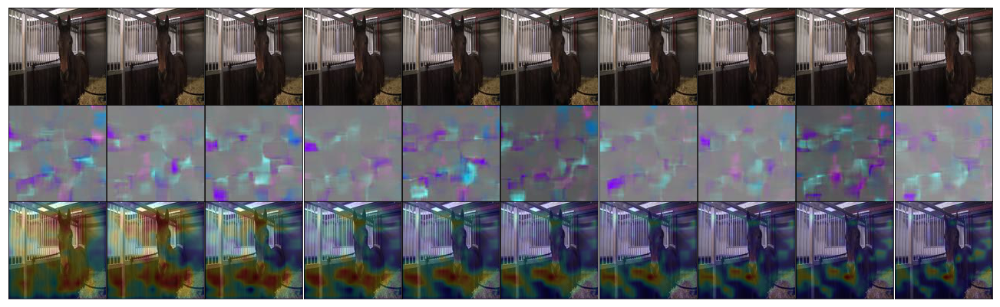

In [28]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=0)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  0
Start index in subject dataframe:  608
                                                    Path  Pain
0  data/jpg_128_128_2fps/horse_1/1_1a_2/frame_000151.jpg     0
1  data/jpg_128_128_2fps/horse_1/1_1a_2/frame_000152.jpg     0
2  data/jpg_128_128_2fps/horse_1/1_1a_2/frame_000153.jpg     0
3  data/jpg_128_128_2fps/horse_1/1_1a_2/frame_000154.jpg     0
4  data/jpg_128_128_2fps/horse_1/1_1a_2/frame_000155.jpg     0
5  data/jpg_128_128_2fps/horse_1/1_1a_2/frame_000156.jpg     0
6  data/jpg_128_128_2fps/horse_1/1_1a_2/frame_000157.jpg     0
7  data/jpg_128_128_2fps/horse_1/1_1a_2/frame_000158.jpg     0
8  data/jpg_128_128_2fps/horse_1/1_1a_2/frame_000159.jpg     0
9  data/jpg_128_128_2fps/horse_1/1_1a_2/frame_000160.jpg     0
[[[0.64966285 0.35099408]
  [0.76092774 0.25008833]
  [0.709546   0.15539232]
  [0.7332663  0.10994698]
  [0.8319424  0.10354772]
  [0.8958439  0.09519824]
  [0.92840695 0.08753289]
  [0.93548864 0.07485031]
  [0.9298034  0.05406862]
  [0.9333881  0.0

/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


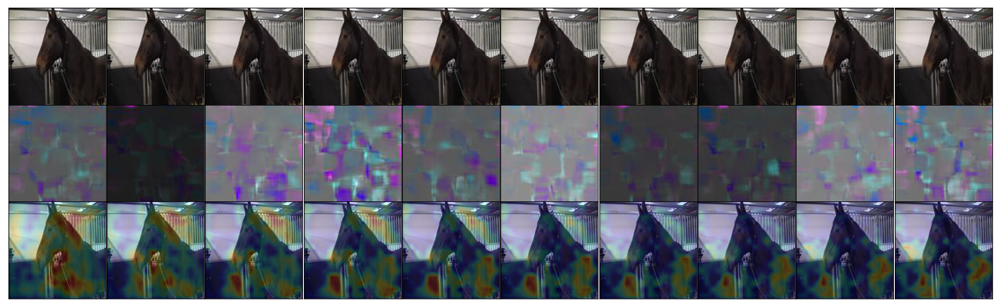

In [29]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=0)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  0
Start index in subject dataframe:  10371
                                                    Path  Pain
0  data/jpg_128_128_2fps/horse_1/1_3a_2/frame_000778.jpg     1
1  data/jpg_128_128_2fps/horse_1/1_3a_2/frame_000779.jpg     1
2  data/jpg_128_128_2fps/horse_1/1_3a_2/frame_000780.jpg     1
3  data/jpg_128_128_2fps/horse_1/1_3a_2/frame_000781.jpg     1
4  data/jpg_128_128_2fps/horse_1/1_3a_2/frame_000782.jpg     1
5  data/jpg_128_128_2fps/horse_1/1_3a_2/frame_000783.jpg     1
6  data/jpg_128_128_2fps/horse_1/1_3a_2/frame_000784.jpg     1
7  data/jpg_128_128_2fps/horse_1/1_3a_2/frame_000785.jpg     1
8  data/jpg_128_128_2fps/horse_1/1_3a_2/frame_000786.jpg     1
9  data/jpg_128_128_2fps/horse_1/1_3a_2/frame_000787.jpg     1
[[[0.49265498 0.48708534]
  [0.19551101 0.70499486]
  [0.03740894 0.8098025 ]
  [0.01298734 0.82656175]
  [0.00999348 0.8577234 ]
  [0.01391659 0.8709038 ]
  [0.02370327 0.86315626]
  [0.0426224  0.8258308 ]
  [0.05844984 0.78552294]
  [0.07312167 0

/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


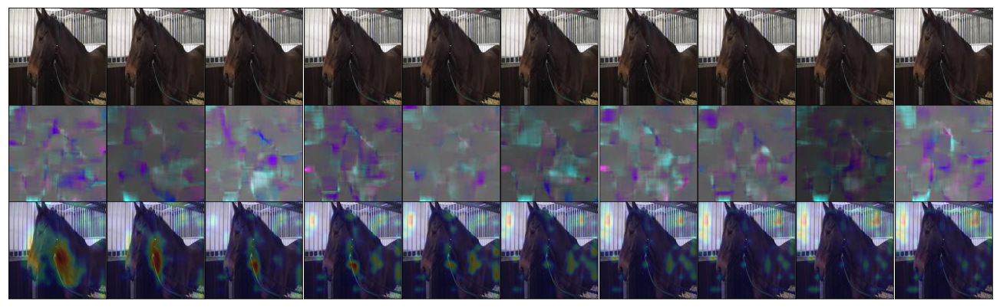

In [30]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=0)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  0
Start index in subject dataframe:  10672
                                                  Path  Pain
0  data/jpg_128_128_2fps/horse_1/1_3b/frame_000179.jpg     1
1  data/jpg_128_128_2fps/horse_1/1_3b/frame_000180.jpg     1
2  data/jpg_128_128_2fps/horse_1/1_3b/frame_000181.jpg     1
3  data/jpg_128_128_2fps/horse_1/1_3b/frame_000182.jpg     1
4  data/jpg_128_128_2fps/horse_1/1_3b/frame_000183.jpg     1
5  data/jpg_128_128_2fps/horse_1/1_3b/frame_000184.jpg     1
6  data/jpg_128_128_2fps/horse_1/1_3b/frame_000185.jpg     1
7  data/jpg_128_128_2fps/horse_1/1_3b/frame_000186.jpg     1
8  data/jpg_128_128_2fps/horse_1/1_3b/frame_000187.jpg     1
9  data/jpg_128_128_2fps/horse_1/1_3b/frame_000188.jpg     1
[[[0.5115515  0.45295915]
  [0.19876873 0.74898714]
  [0.03229102 0.9096182 ]
  [0.01203875 0.9326687 ]
  [0.00873187 0.9226399 ]
  [0.00950259 0.9025673 ]
  [0.01127298 0.84704626]
  [0.02203784 0.77094865]
  [0.04004839 0.6873133 ]
  [0.06284516 0.61460036]]]


/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


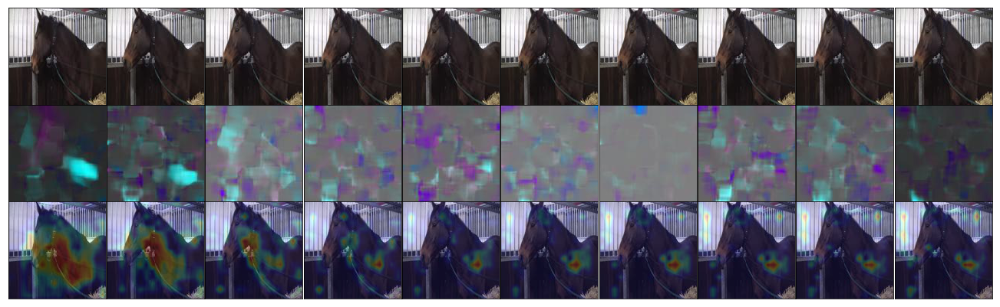

In [31]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=0)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  0
Start index in subject dataframe:  8053
                                                    Path  Pain
0  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_000800.jpg     1
1  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_000801.jpg     1
2  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_000802.jpg     1
3  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_000803.jpg     1
4  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_000804.jpg     1
5  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_000805.jpg     1
6  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_000806.jpg     1
7  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_000807.jpg     1
8  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_000808.jpg     1
9  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_000809.jpg     1
[[[4.93325651e-01 5.14393210e-01]
  [1.20177135e-01 8.79464507e-01]
  [6.87217899e-03 9.65429783e-01]
  [9.65285872e-04 9.76478577e-01]
  [4.85560391e-04 9.80824351e-01]
  [4.59111761e-04 9.82297421e-01]
  [6.39759121e-04 9.78332460e-01]
  [9.8742032

/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


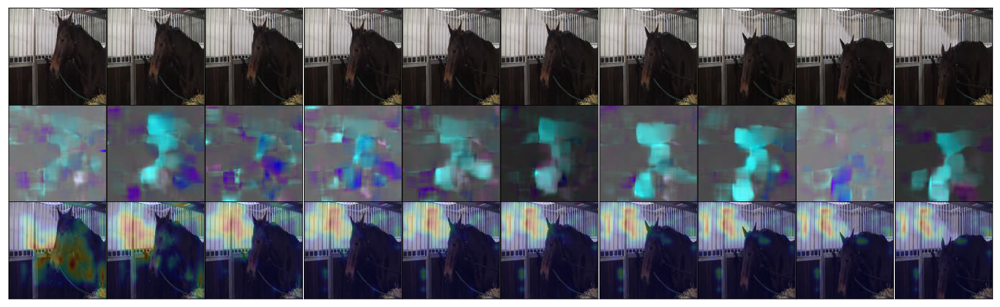

In [32]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=0)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  0
Start index in subject dataframe:  48
                                                    Path  Pain
0  data/jpg_128_128_2fps/horse_1/1_1a_1/frame_000049.jpg     0
1  data/jpg_128_128_2fps/horse_1/1_1a_1/frame_000050.jpg     0
2  data/jpg_128_128_2fps/horse_1/1_1a_1/frame_000051.jpg     0
3  data/jpg_128_128_2fps/horse_1/1_1a_1/frame_000052.jpg     0
4  data/jpg_128_128_2fps/horse_1/1_1a_1/frame_000053.jpg     0
5  data/jpg_128_128_2fps/horse_1/1_1a_1/frame_000054.jpg     0
6  data/jpg_128_128_2fps/horse_1/1_1a_1/frame_000055.jpg     0
7  data/jpg_128_128_2fps/horse_1/1_1a_1/frame_000056.jpg     0
8  data/jpg_128_128_2fps/horse_1/1_1a_1/frame_000057.jpg     0
9  data/jpg_128_128_2fps/horse_1/1_1a_1/frame_000058.jpg     0
[[[0.7011668  0.3083067 ]
  [0.8506006  0.1267749 ]
  [0.78384036 0.03457924]
  [0.76129067 0.01911195]
  [0.85681623 0.01384643]
  [0.9283703  0.01451886]
  [0.96630245 0.01929494]
  [0.9795051  0.0218717 ]
  [0.9864087  0.02283105]
  [0.99002844 0.03

/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


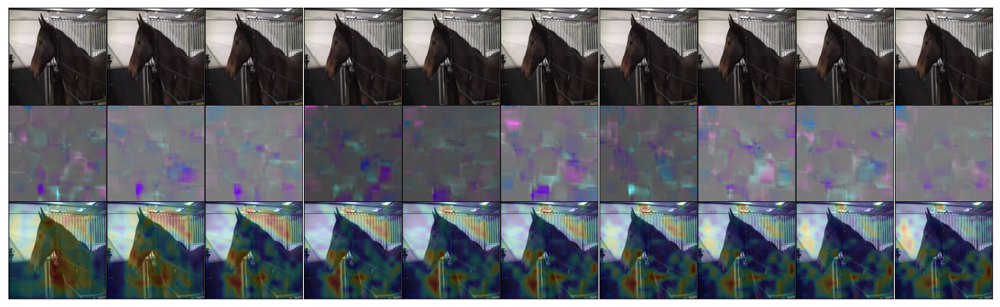

In [33]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=0)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  0
Start index in subject dataframe:  2964
                                                  Path  Pain
0  data/jpg_128_128_2fps/horse_1/1_1b/frame_000293.jpg     0
1  data/jpg_128_128_2fps/horse_1/1_1b/frame_000294.jpg     0
2  data/jpg_128_128_2fps/horse_1/1_1b/frame_000295.jpg     0
3  data/jpg_128_128_2fps/horse_1/1_1b/frame_000296.jpg     0
4  data/jpg_128_128_2fps/horse_1/1_1b/frame_000297.jpg     0
5  data/jpg_128_128_2fps/horse_1/1_1b/frame_000298.jpg     0
6  data/jpg_128_128_2fps/horse_1/1_1b/frame_000299.jpg     0
7  data/jpg_128_128_2fps/horse_1/1_1b/frame_000300.jpg     0
8  data/jpg_128_128_2fps/horse_1/1_1b/frame_000301.jpg     0
9  data/jpg_128_128_2fps/horse_1/1_1b/frame_000302.jpg     0
[[[0.6899157  0.29013813]
  [0.8798829  0.1085678 ]
  [0.83951724 0.05015367]
  [0.7849353  0.03870828]
  [0.84414387 0.04466804]
  [0.8960936  0.06095199]
  [0.93913054 0.09015269]
  [0.9610833  0.10116462]
  [0.96632016 0.10007106]
  [0.9692691  0.08009364]]]


/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


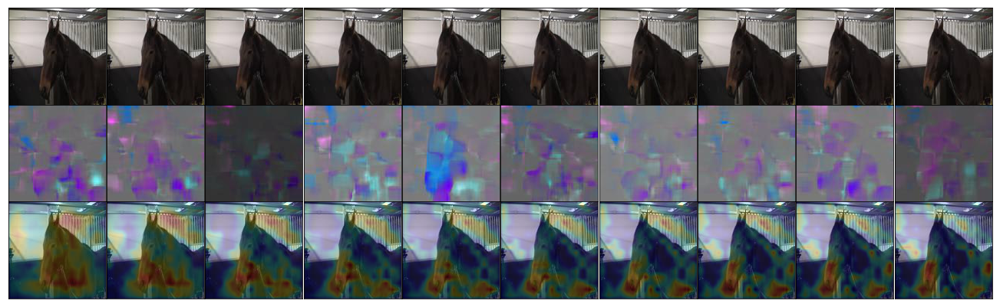

In [34]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=0)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  0
Start index in subject dataframe:  10460
                                                    Path  Pain
0  data/jpg_128_128_2fps/horse_1/1_3a_2/frame_000867.jpg     1
1  data/jpg_128_128_2fps/horse_1/1_3a_2/frame_000868.jpg     1
2  data/jpg_128_128_2fps/horse_1/1_3a_2/frame_000869.jpg     1
3  data/jpg_128_128_2fps/horse_1/1_3a_2/frame_000870.jpg     1
4  data/jpg_128_128_2fps/horse_1/1_3a_2/frame_000871.jpg     1
5  data/jpg_128_128_2fps/horse_1/1_3a_2/frame_000872.jpg     1
6  data/jpg_128_128_2fps/horse_1/1_3a_2/frame_000873.jpg     1
7  data/jpg_128_128_2fps/horse_1/1_3a_2/frame_000874.jpg     1
8  data/jpg_128_128_2fps/horse_1/1_3a_2/frame_000875.jpg     1
9  data/jpg_128_128_2fps/horse_1/1_3a_2/frame_000876.jpg     1
[[[0.5335741  0.41036052]
  [0.20182505 0.6598713 ]
  [0.03854186 0.80332077]
  [0.0224181  0.8907852 ]
  [0.02540084 0.93277264]
  [0.02963329 0.95794934]
  [0.02616042 0.96108365]
  [0.02862709 0.9524595 ]
  [0.03100074 0.95709276]
  [0.03628454 0

/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


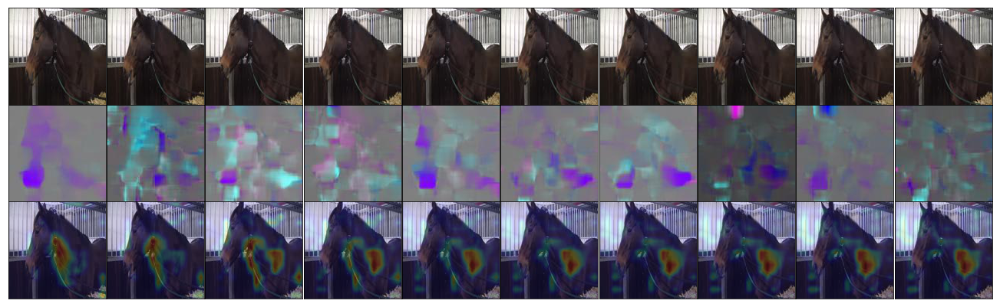

In [35]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=0)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  0
Start index in subject dataframe:  9697
                                                    Path  Pain
0  data/jpg_128_128_2fps/horse_1/1_3a_2/frame_000104.jpg     1
1  data/jpg_128_128_2fps/horse_1/1_3a_2/frame_000105.jpg     1
2  data/jpg_128_128_2fps/horse_1/1_3a_2/frame_000106.jpg     1
3  data/jpg_128_128_2fps/horse_1/1_3a_2/frame_000107.jpg     1
4  data/jpg_128_128_2fps/horse_1/1_3a_2/frame_000108.jpg     1
5  data/jpg_128_128_2fps/horse_1/1_3a_2/frame_000109.jpg     1
6  data/jpg_128_128_2fps/horse_1/1_3a_2/frame_000110.jpg     1
7  data/jpg_128_128_2fps/horse_1/1_3a_2/frame_000111.jpg     1
8  data/jpg_128_128_2fps/horse_1/1_3a_2/frame_000112.jpg     1
9  data/jpg_128_128_2fps/horse_1/1_3a_2/frame_000113.jpg     1
[[[0.54078615 0.43033177]
  [0.1918508  0.73834944]
  [0.01426963 0.8802782 ]
  [0.00274776 0.9175282 ]
  [0.00119628 0.94165087]
  [0.00129064 0.9298623 ]
  [0.00206796 0.8952065 ]
  [0.00390134 0.84582704]
  [0.00614242 0.7975269 ]
  [0.00859754 0.

/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


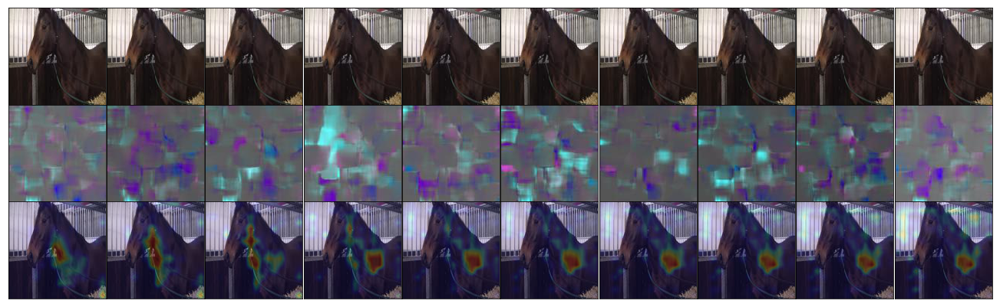

In [36]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=0)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  0
Start index in subject dataframe:  8846
                                                    Path  Pain
0  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_001593.jpg     1
1  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_001594.jpg     1
2  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_001595.jpg     1
3  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_001596.jpg     1
4  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_001597.jpg     1
5  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_001598.jpg     1
6  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_001599.jpg     1
7  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_001600.jpg     1
8  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_001601.jpg     1
9  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_001602.jpg     1
[[[5.1785356e-01 4.3795794e-01]
  [1.5234733e-01 7.4036920e-01]
  [1.3375641e-02 8.5177249e-01]
  [2.3375477e-03 8.6911452e-01]
  [6.8545149e-04 9.2855823e-01]
  [2.6139285e-04 9.5699888e-01]
  [1.4404119e-04 9.7214735e-01]
  [1.6187686e-04 9.7513753

/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


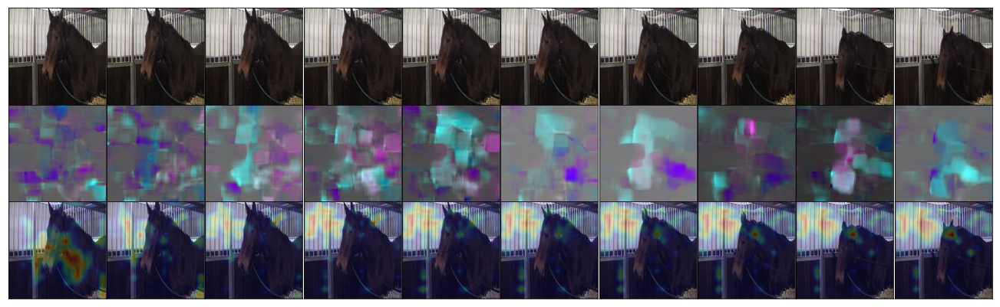

In [37]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=0)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  0
Start index in subject dataframe:  7618
                                                    Path  Pain
0  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_000365.jpg     1
1  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_000366.jpg     1
2  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_000367.jpg     1
3  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_000368.jpg     1
4  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_000369.jpg     1
5  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_000370.jpg     1
6  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_000371.jpg     1
7  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_000372.jpg     1
8  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_000373.jpg     1
9  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_000374.jpg     1
[[[5.1993626e-01 4.2225885e-01]
  [1.6890255e-01 7.7620333e-01]
  [1.4890582e-02 9.4880873e-01]
  [2.0704288e-03 9.8480701e-01]
  [5.7000812e-04 9.9376339e-01]
  [2.5678845e-04 9.9697757e-01]
  [1.7104507e-04 9.9805033e-01]
  [1.7196675e-04 9.9795949

/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


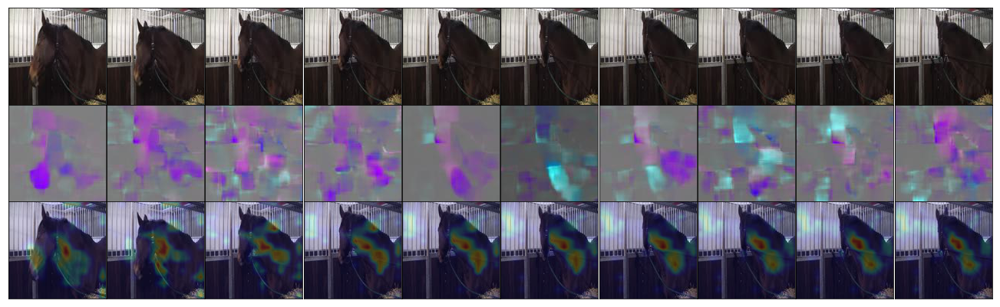

In [38]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=0)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  0
Start index in subject dataframe:  7729
                                                    Path  Pain
0  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_000476.jpg     1
1  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_000477.jpg     1
2  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_000478.jpg     1
3  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_000479.jpg     1
4  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_000480.jpg     1
5  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_000481.jpg     1
6  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_000482.jpg     1
7  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_000483.jpg     1
8  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_000484.jpg     1
9  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_000485.jpg     1
[[[4.9049360e-01 5.0176686e-01]
  [1.7115577e-01 7.9461092e-01]
  [1.7881813e-02 9.1477925e-01]
  [3.2429982e-03 9.4157350e-01]
  [1.5972364e-03 9.5449609e-01]
  [1.2098674e-03 9.6956885e-01]
  [1.1041709e-03 9.7794217e-01]
  [1.2622788e-03 9.7872043

/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


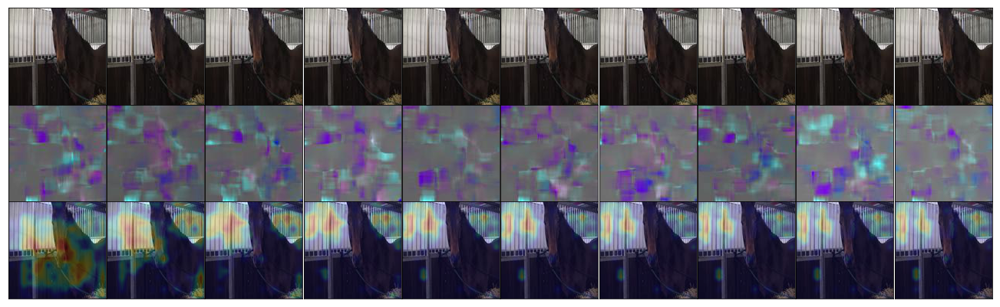

In [39]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=0)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  0
Start index in subject dataframe:  5775
                                                  Path  Pain
0  data/jpg_128_128_2fps/horse_1/1_2a/frame_002128.jpg     0
1  data/jpg_128_128_2fps/horse_1/1_2a/frame_002129.jpg     0
2  data/jpg_128_128_2fps/horse_1/1_2a/frame_002130.jpg     0
3  data/jpg_128_128_2fps/horse_1/1_2a/frame_002131.jpg     0
4  data/jpg_128_128_2fps/horse_1/1_2a/frame_002132.jpg     0
5  data/jpg_128_128_2fps/horse_1/1_2a/frame_002133.jpg     0
6  data/jpg_128_128_2fps/horse_1/1_2a/frame_002134.jpg     0
7  data/jpg_128_128_2fps/horse_1/1_2a/frame_002135.jpg     0
8  data/jpg_128_128_2fps/horse_1/1_2a/frame_002136.jpg     0
9  data/jpg_128_128_2fps/horse_1/1_2a/frame_002137.jpg     0
[[[0.6119815  0.39647195]
  [0.7094484  0.3062366 ]
  [0.6311934  0.17700881]
  [0.53709865 0.11293738]
  [0.46012586 0.09663273]
  [0.3601022  0.1184964 ]
  [0.27502793 0.12893586]
  [0.20688963 0.13569966]
  [0.14590995 0.1454939 ]
  [0.1318692  0.15093543]]]


/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


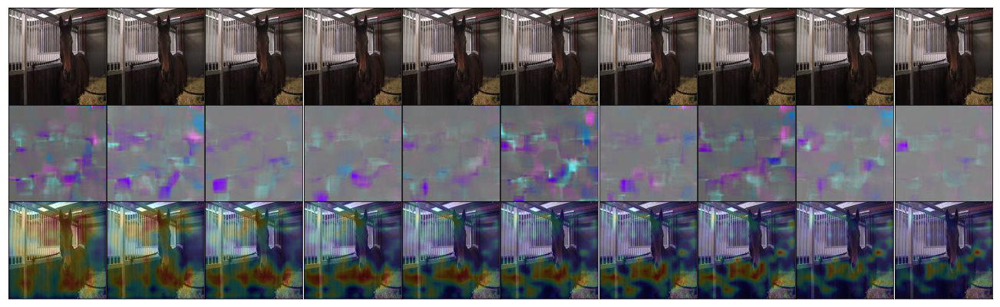

In [40]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=0)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  0
Start index in subject dataframe:  5731
                                                  Path  Pain
0  data/jpg_128_128_2fps/horse_1/1_2a/frame_002084.jpg     0
1  data/jpg_128_128_2fps/horse_1/1_2a/frame_002085.jpg     0
2  data/jpg_128_128_2fps/horse_1/1_2a/frame_002086.jpg     0
3  data/jpg_128_128_2fps/horse_1/1_2a/frame_002087.jpg     0
4  data/jpg_128_128_2fps/horse_1/1_2a/frame_002088.jpg     0
5  data/jpg_128_128_2fps/horse_1/1_2a/frame_002089.jpg     0
6  data/jpg_128_128_2fps/horse_1/1_2a/frame_002090.jpg     0
7  data/jpg_128_128_2fps/horse_1/1_2a/frame_002091.jpg     0
8  data/jpg_128_128_2fps/horse_1/1_2a/frame_002092.jpg     0
9  data/jpg_128_128_2fps/horse_1/1_2a/frame_002093.jpg     0
[[[0.61152023 0.40647143]
  [0.7478187  0.287902  ]
  [0.65536195 0.15067121]
  [0.5511376  0.10209677]
  [0.39838508 0.09443205]
  [0.2490821  0.09648154]
  [0.18247747 0.08961587]
  [0.14421159 0.05898434]
  [0.10514163 0.04330379]
  [0.08513321 0.04060078]]]


/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


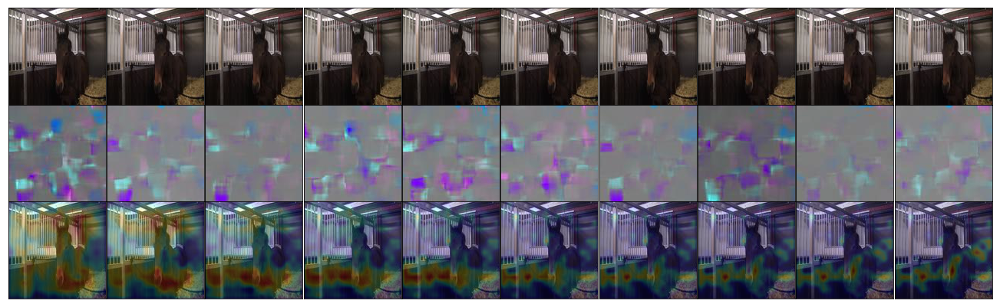

In [41]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=0)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  0
Start index in subject dataframe:  9038
                                                    Path  Pain
0  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_001785.jpg     1
1  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_001786.jpg     1
2  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_001787.jpg     1
3  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_001788.jpg     1
4  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_001789.jpg     1
5  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_001790.jpg     1
6  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_001791.jpg     1
7  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_001792.jpg     1
8  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_001793.jpg     1
9  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_001794.jpg     1
[[[0.5504961  0.4476735 ]
  [0.18345189 0.5947876 ]
  [0.02237501 0.7030013 ]
  [0.00719168 0.74359435]
  [0.0040219  0.79697514]
  [0.00564538 0.86035657]
  [0.01550826 0.88891536]
  [0.03739086 0.88023806]
  [0.03199413 0.8843249 ]
  [0.03506271 0.

/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


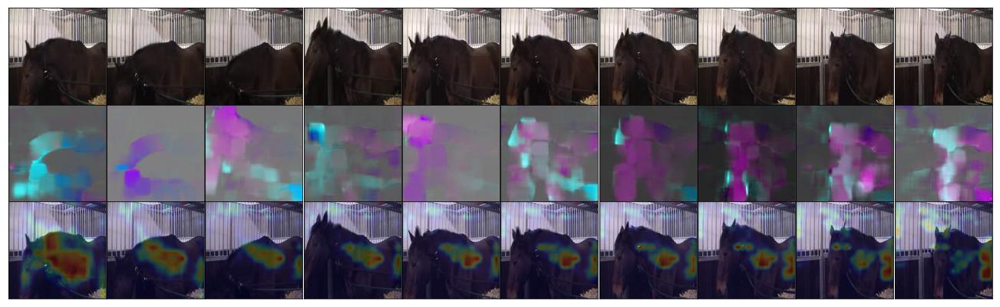

In [42]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=0)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  0
Start index in subject dataframe:  7783
                                                    Path  Pain
0  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_000530.jpg     1
1  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_000531.jpg     1
2  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_000532.jpg     1
3  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_000533.jpg     1
4  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_000534.jpg     1
5  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_000535.jpg     1
6  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_000536.jpg     1
7  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_000537.jpg     1
8  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_000538.jpg     1
9  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_000539.jpg     1
[[[5.2104670e-01 4.6256894e-01]
  [1.2826397e-01 7.7741212e-01]
  [3.5911924e-03 9.2065120e-01]
  [4.6084370e-04 9.6328735e-01]
  [3.1239624e-04 9.7661865e-01]
  [4.3006567e-04 9.8522967e-01]
  [7.7595981e-04 9.8765218e-01]
  [1.9086484e-03 9.8716545

/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


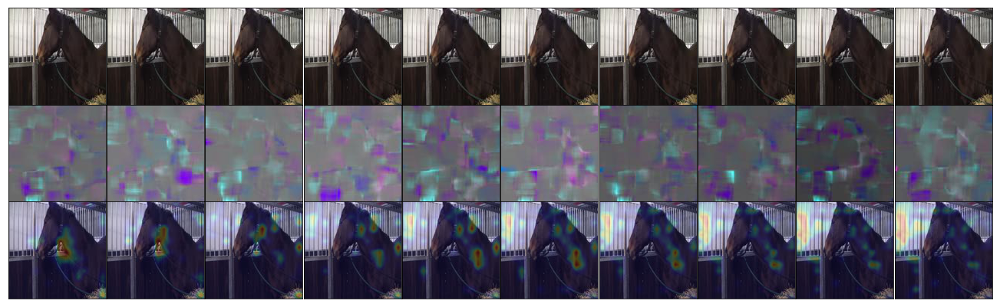

In [43]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=0)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  0
Start index in subject dataframe:  11015
                                                 Path  Pain
0  data/jpg_128_128_2fps/horse_1/1_4/frame_000042.jpg     1
1  data/jpg_128_128_2fps/horse_1/1_4/frame_000043.jpg     1
2  data/jpg_128_128_2fps/horse_1/1_4/frame_000044.jpg     1
3  data/jpg_128_128_2fps/horse_1/1_4/frame_000045.jpg     1
4  data/jpg_128_128_2fps/horse_1/1_4/frame_000046.jpg     1
5  data/jpg_128_128_2fps/horse_1/1_4/frame_000047.jpg     1
6  data/jpg_128_128_2fps/horse_1/1_4/frame_000048.jpg     1
7  data/jpg_128_128_2fps/horse_1/1_4/frame_000049.jpg     1
8  data/jpg_128_128_2fps/horse_1/1_4/frame_000050.jpg     1
9  data/jpg_128_128_2fps/horse_1/1_4/frame_000051.jpg     1
[[[0.62391716 0.38664478]
  [0.5843264  0.5192949 ]
  [0.37259665 0.6351153 ]
  [0.3312583  0.6854897 ]
  [0.39983237 0.7270982 ]
  [0.41113997 0.81431854]
  [0.29006296 0.87044066]
  [0.1896105  0.902972  ]
  [0.17723726 0.9405525 ]
  [0.19543652 0.96778727]]]


/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


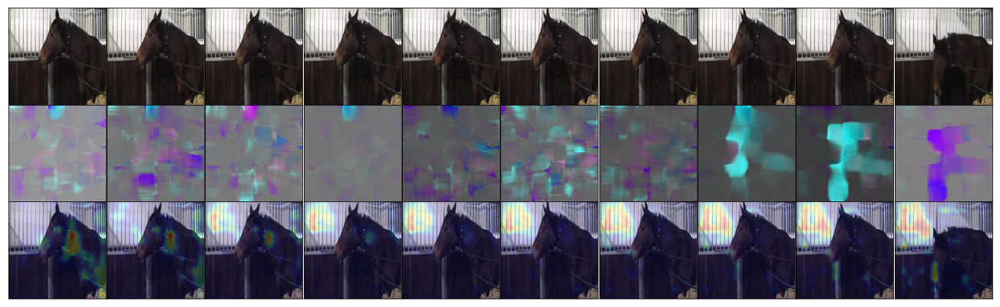

In [44]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=0)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  0
Start index in subject dataframe:  9010
                                                    Path  Pain
0  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_001757.jpg     1
1  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_001758.jpg     1
2  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_001759.jpg     1
3  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_001760.jpg     1
4  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_001761.jpg     1
5  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_001762.jpg     1
6  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_001763.jpg     1
7  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_001764.jpg     1
8  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_001765.jpg     1
9  data/jpg_128_128_2fps/horse_1/1_3a_1/frame_001766.jpg     1
[[[0.5765314  0.40576258]
  [0.2782112  0.6059665 ]
  [0.04735687 0.748154  ]
  [0.01010933 0.80364305]
  [0.00552331 0.84361404]
  [0.00659927 0.8818231 ]
  [0.01147119 0.8852632 ]
  [0.01456334 0.9088162 ]
  [0.0175951  0.90456223]
  [0.01096859 0.

/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


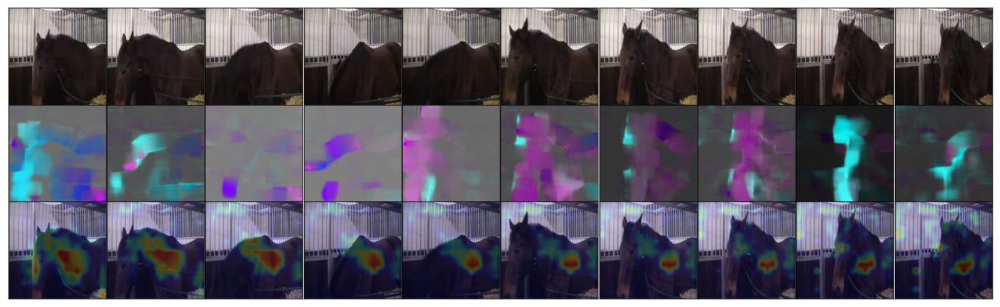

In [45]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=0)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  0
Start index in subject dataframe:  13411
                                                   Path  Pain
0  data/jpg_128_128_2fps/horse_1/1_5_1/frame_000638.jpg     1
1  data/jpg_128_128_2fps/horse_1/1_5_1/frame_000639.jpg     1
2  data/jpg_128_128_2fps/horse_1/1_5_1/frame_000640.jpg     1
3  data/jpg_128_128_2fps/horse_1/1_5_1/frame_000641.jpg     1
4  data/jpg_128_128_2fps/horse_1/1_5_1/frame_000642.jpg     1
5  data/jpg_128_128_2fps/horse_1/1_5_1/frame_000643.jpg     1
6  data/jpg_128_128_2fps/horse_1/1_5_1/frame_000644.jpg     1
7  data/jpg_128_128_2fps/horse_1/1_5_1/frame_000645.jpg     1
8  data/jpg_128_128_2fps/horse_1/1_5_1/frame_000646.jpg     1
9  data/jpg_128_128_2fps/horse_1/1_5_1/frame_000647.jpg     1
[[[0.69418645 0.32202834]
  [0.95244306 0.15366952]
  [0.9866889  0.08988895]
  [0.9900011  0.04659832]
  [0.9862816  0.02880793]
  [0.9816273  0.01574034]
  [0.97169656 0.01477137]
  [0.9706848  0.02925555]
  [0.95990777 0.05337825]
  [0.93685466 0.03986239]]

/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


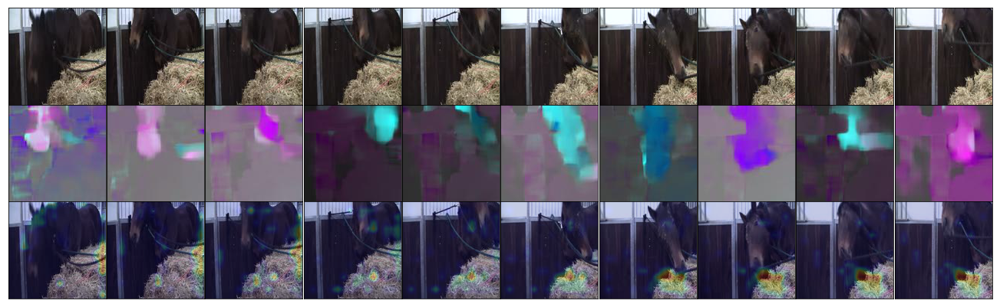

In [46]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=0)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  0
Start index in subject dataframe:  7180
                                                  Path  Pain
0  data/jpg_128_128_2fps/horse_1/1_2b/frame_000863.jpg     0
1  data/jpg_128_128_2fps/horse_1/1_2b/frame_000864.jpg     0
2  data/jpg_128_128_2fps/horse_1/1_2b/frame_000865.jpg     0
3  data/jpg_128_128_2fps/horse_1/1_2b/frame_000866.jpg     0
4  data/jpg_128_128_2fps/horse_1/1_2b/frame_000867.jpg     0
5  data/jpg_128_128_2fps/horse_1/1_2b/frame_000868.jpg     0
6  data/jpg_128_128_2fps/horse_1/1_2b/frame_000869.jpg     0
7  data/jpg_128_128_2fps/horse_1/1_2b/frame_000870.jpg     0
8  data/jpg_128_128_2fps/horse_1/1_2b/frame_000871.jpg     0
9  data/jpg_128_128_2fps/horse_1/1_2b/frame_000872.jpg     0
[[[0.64564776 0.37550333]
  [0.7984799  0.305588  ]
  [0.7549993  0.19916867]
  [0.8023235  0.1147632 ]
  [0.8744734  0.06233078]
  [0.8937263  0.04822211]
  [0.88939553 0.05461007]
  [0.821628   0.06918509]
  [0.8015219  0.09271838]
  [0.72988516 0.14291957]]]


/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


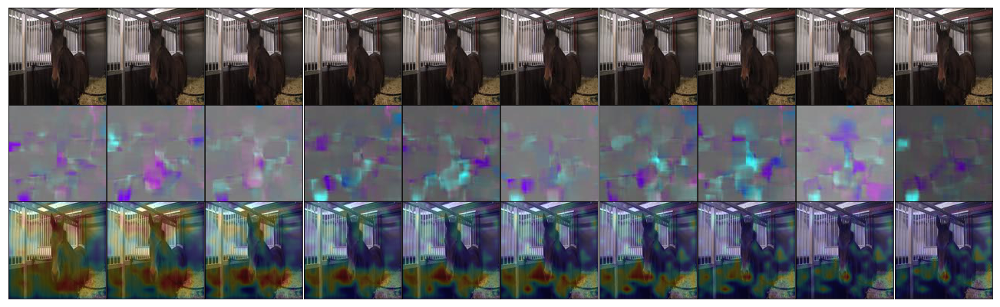

In [47]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=0)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  0
Start index in subject dataframe:  13076
                                                   Path  Pain
0  data/jpg_128_128_2fps/horse_1/1_5_1/frame_000303.jpg     1
1  data/jpg_128_128_2fps/horse_1/1_5_1/frame_000304.jpg     1
2  data/jpg_128_128_2fps/horse_1/1_5_1/frame_000305.jpg     1
3  data/jpg_128_128_2fps/horse_1/1_5_1/frame_000306.jpg     1
4  data/jpg_128_128_2fps/horse_1/1_5_1/frame_000307.jpg     1
5  data/jpg_128_128_2fps/horse_1/1_5_1/frame_000308.jpg     1
6  data/jpg_128_128_2fps/horse_1/1_5_1/frame_000309.jpg     1
7  data/jpg_128_128_2fps/horse_1/1_5_1/frame_000310.jpg     1
8  data/jpg_128_128_2fps/horse_1/1_5_1/frame_000311.jpg     1
9  data/jpg_128_128_2fps/horse_1/1_5_1/frame_000312.jpg     1
[[[0.6376982  0.36729535]
  [0.7520808  0.2932758 ]
  [0.75102603 0.27400082]
  [0.7986922  0.26720363]
  [0.8468267  0.31106886]
  [0.8719441  0.23448946]
  [0.88958174 0.15851536]
  [0.9217493  0.10427952]
  [0.931022   0.05268204]
  [0.92000425 0.02282299]]

/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


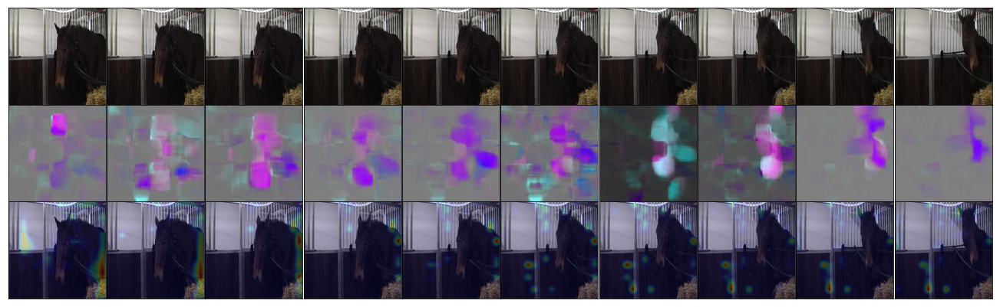

In [48]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=0)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  0
Start index in subject dataframe:  6884
                                                  Path  Pain
0  data/jpg_128_128_2fps/horse_1/1_2b/frame_000567.jpg     0
1  data/jpg_128_128_2fps/horse_1/1_2b/frame_000568.jpg     0
2  data/jpg_128_128_2fps/horse_1/1_2b/frame_000569.jpg     0
3  data/jpg_128_128_2fps/horse_1/1_2b/frame_000570.jpg     0
4  data/jpg_128_128_2fps/horse_1/1_2b/frame_000571.jpg     0
5  data/jpg_128_128_2fps/horse_1/1_2b/frame_000572.jpg     0
6  data/jpg_128_128_2fps/horse_1/1_2b/frame_000573.jpg     0
7  data/jpg_128_128_2fps/horse_1/1_2b/frame_000574.jpg     0
8  data/jpg_128_128_2fps/horse_1/1_2b/frame_000575.jpg     0
9  data/jpg_128_128_2fps/horse_1/1_2b/frame_000576.jpg     0
[[[0.65592533 0.28690583]
  [0.8954112  0.06835239]
  [0.9582923  0.01201141]
  [0.97393733 0.00566798]
  [0.97934765 0.00759297]
  [0.9832339  0.01475529]
  [0.98245585 0.02665572]
  [0.9746543  0.0471637 ]
  [0.9644252  0.06048793]
  [0.94633365 0.08092988]]]


/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


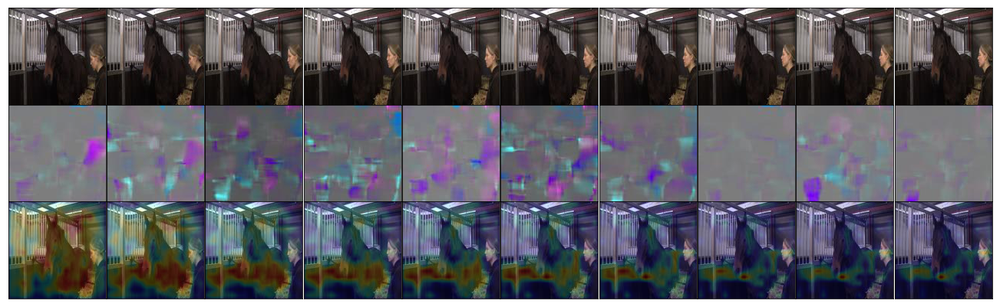

In [49]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=0)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  0
Start index in subject dataframe:  4702
                                                  Path  Pain
0  data/jpg_128_128_2fps/horse_1/1_2a/frame_001055.jpg     0
1  data/jpg_128_128_2fps/horse_1/1_2a/frame_001056.jpg     0
2  data/jpg_128_128_2fps/horse_1/1_2a/frame_001057.jpg     0
3  data/jpg_128_128_2fps/horse_1/1_2a/frame_001058.jpg     0
4  data/jpg_128_128_2fps/horse_1/1_2a/frame_001059.jpg     0
5  data/jpg_128_128_2fps/horse_1/1_2a/frame_001060.jpg     0
6  data/jpg_128_128_2fps/horse_1/1_2a/frame_001061.jpg     0
7  data/jpg_128_128_2fps/horse_1/1_2a/frame_001062.jpg     0
8  data/jpg_128_128_2fps/horse_1/1_2a/frame_001063.jpg     0
9  data/jpg_128_128_2fps/horse_1/1_2a/frame_001064.jpg     0
[[[0.46565872 0.46371612]
  [0.5594784  0.44297668]
  [0.6309787  0.29000828]
  [0.68573964 0.25299677]
  [0.77200663 0.328852  ]
  [0.8365795  0.3912916 ]
  [0.8631425  0.46489155]
  [0.842963   0.5188201 ]
  [0.79427356 0.49079773]
  [0.76278514 0.4071698 ]]]


/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


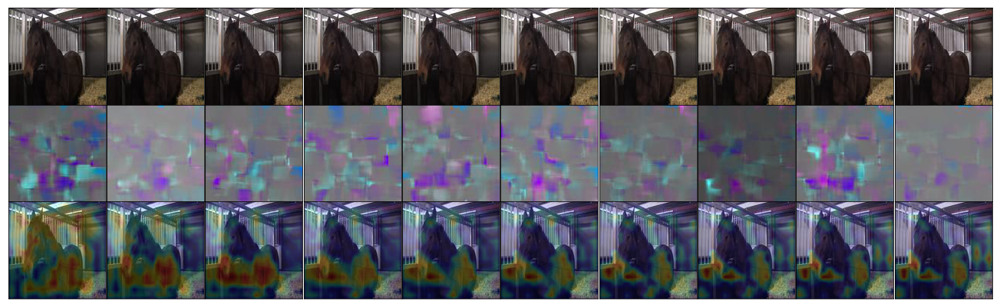

In [50]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=0)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  0
Start index in subject dataframe:  1368
                                                    Path  Pain
0  data/jpg_128_128_2fps/horse_1/1_1a_3/frame_000649.jpg     0
1  data/jpg_128_128_2fps/horse_1/1_1a_3/frame_000650.jpg     0
2  data/jpg_128_128_2fps/horse_1/1_1a_3/frame_000651.jpg     0
3  data/jpg_128_128_2fps/horse_1/1_1a_3/frame_000652.jpg     0
4  data/jpg_128_128_2fps/horse_1/1_1a_3/frame_000653.jpg     0
5  data/jpg_128_128_2fps/horse_1/1_1a_3/frame_000654.jpg     0
6  data/jpg_128_128_2fps/horse_1/1_1a_3/frame_000655.jpg     0
7  data/jpg_128_128_2fps/horse_1/1_1a_3/frame_000656.jpg     0
8  data/jpg_128_128_2fps/horse_1/1_1a_3/frame_000657.jpg     0
9  data/jpg_128_128_2fps/horse_1/1_1a_3/frame_000658.jpg     0
[[[0.70642304 0.33362743]
  [0.8425798  0.22939707]
  [0.73891425 0.12939107]
  [0.58362055 0.08625948]
  [0.5416986  0.06415464]
  [0.57213944 0.05091907]
  [0.62850946 0.05858118]
  [0.6987256  0.05801382]
  [0.7260499  0.05589896]
  [0.75872386 0.

/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/__init__.py:424: MatplotlibDeprecationWarning: 
Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warn_deprecated("2.2", "Passing one of 'on', 'true', 'off', 'false' as a "


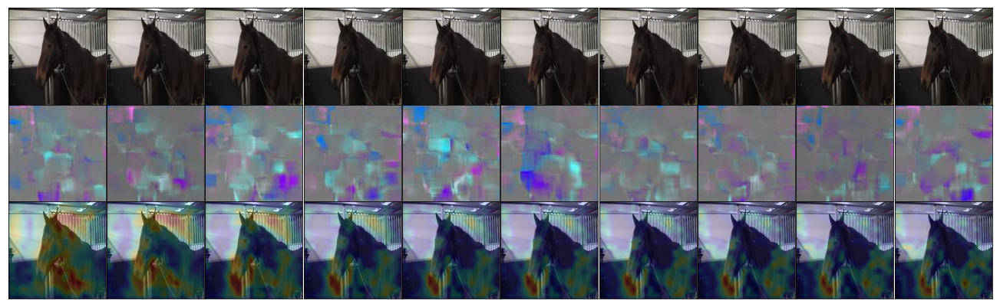

In [17]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=0, start_index=1368)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);